# DETR

In [6]:
from VIA2COCO import convert
import os

In [7]:
data_path = 'E:\\Распознавание образов\\29.03.24\\'

In [7]:
first_class_index = 0

for keyword in ['train', 'val']:

  #input_dir = data_path + keyword + '/'
  #input_json = input_dir + 'via_region_data.json'
  folder_path = os.curdir
  print(folder_path)

  

  input_dir = data_path + 'balloon\\train\\'
  input_json = data_path + 'balloon\\train\\via_region_data.json'
  categories = ['balloon']
  super_categories = ['N/A']
  output_json = input_dir + 'custom_' + keyword + '.json'

  print('Конвертируем {} из VIA формата в COCO формат'.format(input_json))

  coco_dict = convert.convert(
      imgdir=input_dir,
      annpath=input_json,
      categories=categories,
      super_categories=super_categories,
      output_file_name=output_json,
      first_class_index=first_class_index,
  )

  input_dir = data_path + 'balloon\\val\\'
  input_json = data_path + 'balloon\\val\\via_region_data.json'

  output_json = input_dir + 'custom_' + keyword + '.json'
  coco_dict = convert.convert(
      imgdir=input_dir,
      annpath=input_json,
      categories=categories,
      super_categories=super_categories,
      output_file_name=output_json,
      first_class_index=first_class_index,
  )

.
Конвертируем E:\Распознавание образов\29.03.24\balloon\train\via_region_data.json из VIA формата в COCO формат
Saving to E:\Распознавание образов\29.03.24\balloon\train\custom_train.json
Saving to E:\Распознавание образов\29.03.24\balloon\val\custom_train.json
.
Конвертируем E:\Распознавание образов\29.03.24\balloon\train\via_region_data.json из VIA формата в COCO формат


Saving to E:\Распознавание образов\29.03.24\balloon\train\custom_val.json
Saving to E:\Распознавание образов\29.03.24\balloon\val\custom_val.json


In [8]:
import torchvision
import os

class CocoDetection(torchvision.datasets.CocoDetection):
    def __init__(self, img_folder, feature_extractor, train=True):
        ann_file = os.path.join(img_folder, "custom_train.json" if train else "custom_val.json")
        super(CocoDetection, self).__init__(img_folder, ann_file)
        self.feature_extractor = feature_extractor

    def __getitem__(self, idx):
        # считывание изображения и ожидаемого ответа (лейбл или target) в формат COCO
        img, target = super(CocoDetection, self).__getitem__(idx)

        # обработать изображение и таргет (привести target к формату DETR,
        # изменить размер, нормализовать)
        image_id = self.ids[idx]
        target = {'image_id': image_id, 'annotations': target}
        encoding = self.feature_extractor(images=img, annotations=target, return_tensors="pt")
        pixel_values = encoding["pixel_values"].squeeze() # удалить размер batch
        target = encoding["labels"][0] # удалить размер batch

        return pixel_values, target

In [10]:
from transformers import AutoFeatureExtractor

feature_extractor = AutoFeatureExtractor.from_pretrained("hustvl/yolos-small", size=512, max_size=864)

train_dataset = CocoDetection(img_folder=data_path + 'balloon/train', feature_extractor=feature_extractor)
val_dataset = CocoDetection(img_folder=data_path + 'balloon/val', feature_extractor=feature_extractor, train=False)

f:\test\29.03.24\.venv\Lib\site-packages\transformers\models\yolos\feature_extraction_yolos.py:38: FutureWarning: The class YolosFeatureExtractor is deprecated and will be removed in version 5 of Transformers. Please use YolosImageProcessor instead.
  warnings.warn(
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.


loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!


In [11]:
print("Number of training examples:", len(train_dataset))
print("Number of validation examples:", len(val_dataset))

Number of training examples: 61
Number of validation examples: 13


Image: 7


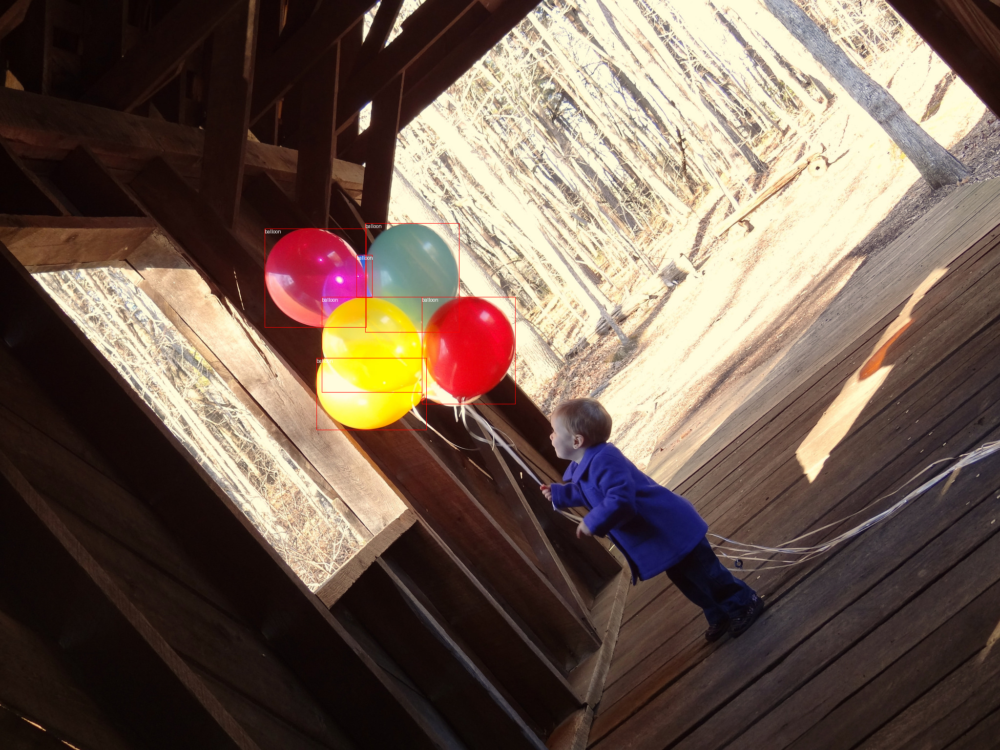

In [12]:
import numpy as np
import os
from PIL import Image, ImageDraw

# используя
# https://github.com/woctezuma/finetune-detr/blob/master/finetune_detr.ipynb
image_ids = train_dataset.coco.getImgIds()

image_id = image_ids[np.random.randint(0, len(image_ids))]
print('Image: {}'.format(image_id))
image = train_dataset.coco.loadImgs(image_id)[0]
image = Image.open(os.path.join(data_path + 'balloon/train', image['file_name']))

annotations = train_dataset.coco.imgToAnns[image_id]
draw = ImageDraw.Draw(image, "RGBA")

cats = train_dataset.coco.cats
id2label = {k: v['name'] for k,v in cats.items()}

for annotation in annotations:
  box = annotation['bbox']
  class_idx = annotation['category_id']
  x,y,w,h = tuple(box)
  draw.rectangle((x,y,x+w,y+h), outline='red', width=1)
  draw.text((x, y), id2label[class_idx], fill='white')

image

In [13]:
from torch.utils.data import DataLoader

def collate_fn(batch):
  pixel_values = [item[0] for item in batch]
  encoding = feature_extractor.pad(pixel_values, return_tensors="pt")
  labels = [item[1] for item in batch]
  batch = {}
  batch['pixel_values'] = encoding['pixel_values']
  batch['labels'] = labels
  return batch

train_dataloader = DataLoader(train_dataset, collate_fn=collate_fn, batch_size=1, shuffle=True)
val_dataloader = DataLoader(val_dataset, collate_fn=collate_fn, batch_size=1)
batch = next(iter(train_dataloader))

In [14]:
batch.keys()

dict_keys(['pixel_values', 'labels'])

In [15]:
pixel_values, target = train_dataset[0]

In [16]:
pixel_values.shape

torch.Size([3, 512, 672])

In [17]:
print(target)

{'size': tensor([512, 672]), 'image_id': tensor([0]), 'class_labels': tensor([0]), 'boxes': tensor([[0.5955, 0.5811, 0.2202, 0.3561]]), 'area': tensor([1485.3125]), 'iscrowd': tensor([0]), 'orig_size': tensor([1536, 2048])}


In [18]:
import pytorch_lightning as pl
from transformers import DetrConfig, AutoModelForObjectDetection
import torch

In [19]:
class Detr(pl.LightningModule):
     def __init__(self, lr, weight_decay):
         super().__init__()

         self.model = AutoModelForObjectDetection.from_pretrained("hustvl/yolos-small",
                                                             num_labels=len(id2label),
                                                             ignore_mismatched_sizes=True)
         self.lr = lr
         self.weight_decay = weight_decay

     def forward(self, pixel_values):
       outputs = self.model(pixel_values=pixel_values)

       return outputs

     def common_step(self, batch, batch_idx):
       pixel_values = batch["pixel_values"]
       labels = [{k: v.to(self.device) for k, v in t.items()} for t in batch["labels"]]

       outputs = self.model(pixel_values=pixel_values, labels=labels)

       loss = outputs.loss
       loss_dict = outputs.loss_dict

       return loss, loss_dict

     def training_step(self, batch, batch_idx):
        loss, loss_dict = self.common_step(batch, batch_idx)
        self.log("training_loss", loss)
        for k,v in loss_dict.items():
          self.log("train_" + k, v.item())

        return loss

     def validation_step(self, batch, batch_idx):
        loss, loss_dict = self.common_step(batch, batch_idx)
        self.log("validation_loss", loss)
        for k,v in loss_dict.items():
          self.log("validation_" + k, v.item())

        return loss

     def configure_optimizers(self):
        optimizer = torch.optim.AdamW(self.parameters(), lr=self.lr,
                                  weight_decay=self.weight_decay)

        return optimizer

     def train_dataloader(self):
        return train_dataloader

     def val_dataloader(self):
        return val_dataloader

In [21]:
# Используем tensorboard.
%load_ext tensorboard
%tensorboard --logdir lightning_logs/

Launching TensorBoard...

In [22]:
model = Detr(lr=2.5e-5, weight_decay=1e-4)

outputs = model(pixel_values=batch['pixel_values'])

Error during conversion: ValueError('Queue is full! Please try again.')
Some weights of YolosForObjectDetection were not initialized from the model checkpoint at hustvl/yolos-small and are newly initialized because the shapes did not match:
- class_labels_classifier.layers.2.weight: found shape torch.Size([92, 384]) in the checkpoint and torch.Size([2, 384]) in the model instantiated
- class_labels_classifier.layers.2.bias: found shape torch.Size([92]) in the checkpoint and torch.Size([2]) in the model instantiated
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


In [25]:
from pytorch_lightning import Trainer

trainer = Trainer(accelerator='auto', max_steps=100, gradient_clip_val=0.1, accumulate_grad_batches=4, max_epochs=2)
trainer.fit(model)

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs



  | Name  | Type                    | Params
--------------------------------------------------
0 | model | YolosForObjectDetection | 30.7 M
--------------------------------------------------
30.7 M    Trainable params
0         Non-trainable params
30.7 M    Total params
122.600   Total estimated model params size (MB)


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

`Trainer.fit` stopped: `max_epochs=2` reached.


In [ ]:
import datasets.t

In [34]:
from detr.datasets import get_coco_api_from_dataset
import detr.datasets as datasets

base_ds = get_coco_api_from_dataset(val_dataset)

In [39]:
from detr.datasets.coco_eval import CocoEvaluator
from tqdm.notebook import tqdm

iou_types = ['bbox']
coco_evaluator = CocoEvaluator(base_ds, iou_types)

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

model.to(device)
model.eval()

Detr(
  (model): YolosForObjectDetection(
    (vit): YolosModel(
      (embeddings): YolosEmbeddings(
        (patch_embeddings): YolosPatchEmbeddings(
          (projection): Conv2d(3, 384, kernel_size=(16, 16), stride=(16, 16))
        )
        (dropout): Dropout(p=0.0, inplace=False)
        (interpolation): InterpolateInitialPositionEmbeddings()
      )
      (encoder): YolosEncoder(
        (layer): ModuleList(
          (0-11): 12 x YolosLayer(
            (attention): YolosAttention(
              (attention): YolosSelfAttention(
                (query): Linear(in_features=384, out_features=384, bias=True)
                (key): Linear(in_features=384, out_features=384, bias=True)
                (value): Linear(in_features=384, out_features=384, bias=True)
                (dropout): Dropout(p=0.0, inplace=False)
              )
              (output): YolosSelfOutput(
                (dense): Linear(in_features=384, out_features=384, bias=True)
                (dropout): Dropo

In [40]:
!pip install ipywidgets

In [41]:
!jupyter nbextension enable --py widgetsnbextension

usage: jupyter [-h] [--version] [--config-dir] [--data-dir] [--runtime-dir]
               [--paths] [--json] [--debug]
               [subcommand]

Jupyter: Interactive Computing

positional arguments:
  subcommand     the subcommand to launch

options:
  -h, --help     show this help message and exit
  --version      show the versions of core jupyter packages and exit
  --config-dir   show Jupyter config dir
  --data-dir     show Jupyter data dir
  --runtime-dir  show Jupyter runtime dir
  --paths        show all Jupyter paths. Add --json for machine-readable
                 format.
  --json         output paths as machine-readable json
  --debug        output debug information about paths

Available subcommands: contrib dejavu events execute kernel kernelspec lab
labextension labhub migrate nbconvert nbextensions_configurator notebook run
server troubleshoot trust

Jupyter command `jupyter-nbextension` not found.


In [42]:
!pip install jupyter_contrib_nbextensions

In [43]:
print("Запуск оценки...")

for idx, batch in enumerate(tqdm(val_dataloader)):
    pixel_values = batch["pixel_values"].to(device)
    labels = [{k: v.to(device) for k, v in t.items()} for t in batch["labels"]]

    outputs = model.model(pixel_values=pixel_values)
    orig_target_sizes = torch.stack([target["orig_size"] for target in labels], dim=0)
    results = feature_extractor.post_process(outputs, orig_target_sizes)
    res = {target['image_id'].item(): output for target, output in zip(labels, results)}
    coco_evaluator.update(res)

coco_evaluator.synchronize_between_processes()
coco_evaluator.accumulate()
coco_evaluator.summarize()

Запуск оценки...


  0%|          | 0/13 [00:00<?, ?it/s]

`post_process` is deprecated and will be removed in v5 of Transformers, please use `post_process_object_detection` instead, with `threshold=0.` for equivalent results.


Accumulating evaluation results...
DONE (t=0.10s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.401
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.530
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.451
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.342
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.642
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.174
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.468
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.512
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.352
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.700
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= l

## Использование и визуализация

Визуализируем предсказания DETR на некотором изображении из val.

In [44]:
pixel_values, target = val_dataset[1]

In [45]:
pixel_values = pixel_values.unsqueeze(0).to(device)
print(pixel_values.shape)

torch.Size([1, 3, 672, 512])


In [46]:
outputs = model(pixel_values=pixel_values)

In [47]:
import torch
import matplotlib.pyplot as plt

COLORS = [[0.000, 0.447, 0.741], [0.850, 0.325, 0.098], [0.929, 0.694, 0.125],
          [0.494, 0.184, 0.556], [0.466, 0.674, 0.188], [0.301, 0.745, 0.933]]

def box_cxcywh_to_xyxy(x):
    x_c, y_c, w, h = x.unbind(1)
    b = [(x_c - 0.5 * w), (y_c - 0.5 * h),
         (x_c + 0.5 * w), (y_c + 0.5 * h)]
    return torch.stack(b, dim=1)

def rescale_bboxes(out_bbox, size):
    img_w, img_h = size
    b = box_cxcywh_to_xyxy(out_bbox)
    b = b * torch.tensor([img_w, img_h, img_w, img_h], dtype=torch.float32)
    return b

def plot_results(pil_img, prob, boxes):
    plt.figure(figsize=(16,10))
    plt.imshow(pil_img)
    ax = plt.gca()
    colors = COLORS * 100
    for p, (xmin, ymin, xmax, ymax), c in zip(prob, boxes.tolist(), colors):
        ax.add_patch(plt.Rectangle((xmin, ymin), xmax - xmin, ymax - ymin,
                                   fill=False, color=c, linewidth=3))
        cl = p.argmax()
        text = f'{id2label[cl.item()]}: {p[cl]:0.2f}'
        ax.text(xmin, ymin, text, fontsize=15,
                bbox=dict(facecolor='yellow', alpha=0.5))
    plt.axis('off')
    plt.show()

In [48]:
def visualize_predictions(image, outputs, threshold=0.9):
  # визуализировать рамки для предсказаний, которые выше порогового значения
  probas = outputs.logits.softmax(-1)[0, :, :-1]
  keep = probas.max(-1).values > threshold

  # конветировать рамки предсказаний для конкретного изображения
  bboxes_scaled = rescale_bboxes(outputs.pred_boxes[0, keep].cpu(), image.size)

  plot_results(image, probas[keep], bboxes_scaled)

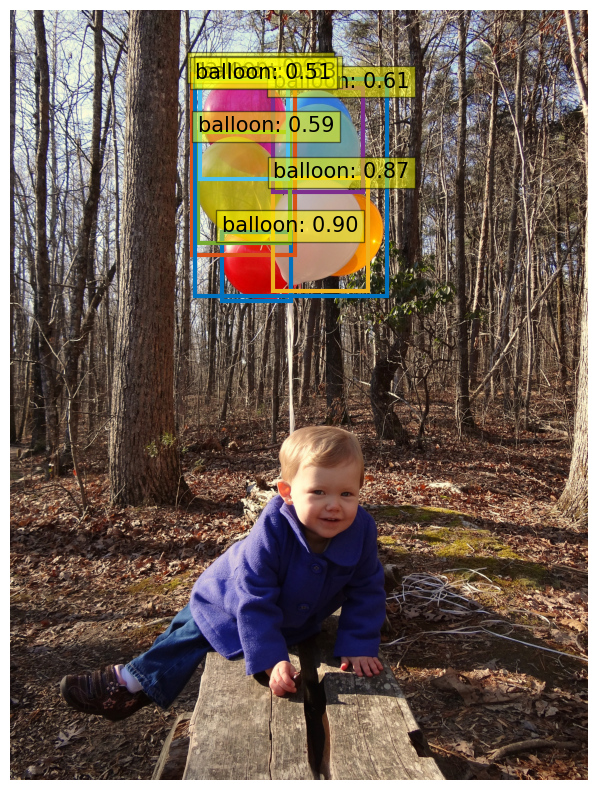

In [53]:
image_id = target['image_id'].item()
image = val_dataset.coco.loadImgs(image_id)[0]
image = Image.open(os.path.join(data_path + 'balloon\\val', image['file_name']))

visualize_predictions(image, outputs, threshold=0.5)

P.S. На данном этапе модель не обучена... Постарайся получить результаты получше :)

# Yolo

## Установка

In [ ]:
!git clone https://github.com/ultralytics/yolov5

Cloning into 'yolov5'...


In [54]:
!pip install utils

In [1]:
%cd yolov5

f:\test\29.03.24\yolov5


In [2]:
import torch
import yolov5.utils
display = yolov5.utils.notebook_init()

YOLOv5  v7.0-295-gac6c4383 Python-3.11.2 torch-2.2.0+cpu CPU


Setup complete  (8 CPUs, 5.9 GB RAM, 26.8/203.0 GB disk)


In [14]:
!python detect.py --weights yolov5s.pt --img 640 --conf 0.25 --source data/images

requirements: Ultralytics requirements ['datasets==2.18.0', 'transforms==0.2.1'] not found, attempting AutoUpdate...

































requirements: AutoUpdate success ✅ 7.3s, installed 2 packages: ['datasets==2.18.0', 'transforms==0.2.1']
requirements: ⚠️ Restart runtime or rerun command for updates to take effect



detect: weights=['yolov5s.pt'], source=data/images, data=data\coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_csv=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs\detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5  v7.0-295-gac6c4383 Python-3.11.2 torch-2.2.0+cpu CPU

Fusing layers... 
YOLOv5s summary: 213 layers, 7225885 parameters, 0 gradients, 16.4 GFLOPs
image 1/2 F:\test\29.03.24\yolov5\data\images\bus.jpg: 640x480 4 persons, 1 bus, 516.8ms
image 2/2 F:\test\29.03.24\yolov5\data\images\zidane.jpg: 384x640 2 persons, 2 ties, 416.6ms
Speed: 5.3ms pre-process, 466.7ms inference, 23.2ms NMS per image at shape (1, 3, 640, 640)
Results saved to runs\detect\exp


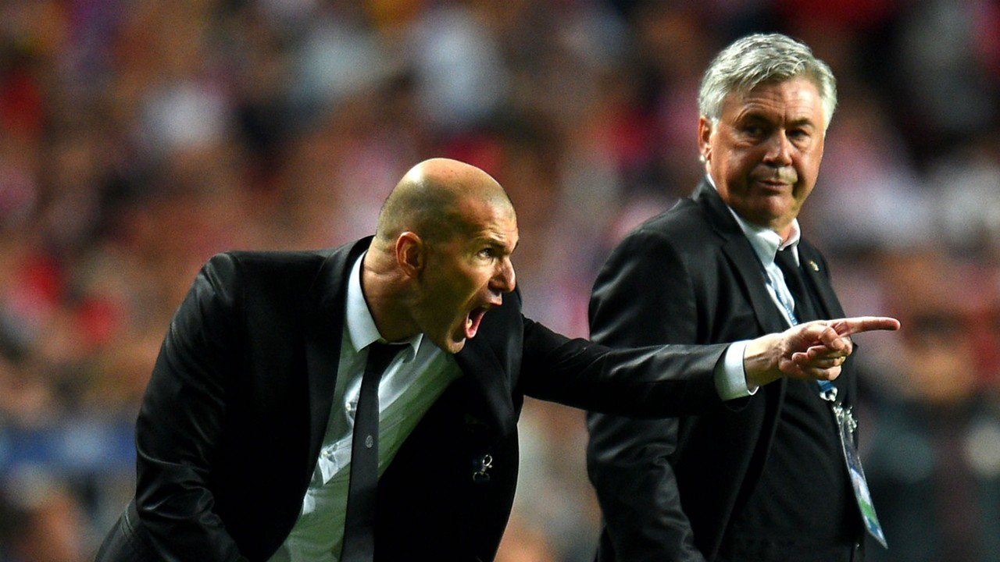

In [15]:
display.Image(filename=data_path+'yolov5\\data\\images\\zidane.jpg', width=600)

In [17]:
# Download COCO val
torch.hub.download_url_to_file('https://ultralytics.com/assets/coco2017val.zip', 'tmp.zip')  # download (780M - 5000 images)
!unzip -q tmp.zip -d ../datasets && rm tmp.zip  # unzip

  3%|▎         | 23.7M/780M [00:14<07:44, 1.71MB/s] 


KeyboardInterrupt: 

In [16]:
!python val.py --weights yolov5s.pt --data coco.yaml --img 640 --half

requirements: Ultralytics requirements ['datasets==2.18.0', 'transforms==0.2.1'] not found, attempting AutoUpdate...

val: data=F:\test\29.03.24\yolov5\data\coco.yaml, weights=['yolov5s.pt'], batch_size=32, imgsz=640, conf_thres=0.001, iou_thres=0.6, max_det=300, task=val, device=, workers=8, single_cls=False, augment=False, verbose=False, save_txt=False, save_hybrid=False, save_conf=False, save_json=True, project=runs\val, name=exp, exist_ok=False, half=True, dnn=False
YOLOv5  v7.0-295-gac6c4383 Python-3.11.2 torch-2.2.0+cpu CPU

Fusing layers... 
YOLOv5s summary: 213 layers, 7225885 parameters, 0 gradients, 16.4 GFLOPs

val: Scanning F:\test\29.03.24\datasets\coco\val2017...:   0%|          | 0/5000 [00:00<?, ?it/s]
val: Scanning F:\test\29.03.24\datasets\coco\val2017... 0 images, 0 backgrounds, 1 corrupt:   0%|          | 1/5000 [00:16<22:51:41, 16.46s/it]
val: Scanning F:\test\29.03.24\datasets\coco\val2017... 0 images, 0 backgrounds, 458 corrupt:   9%|▉         | 458/5000 [00:16<01:55, 39.37it/s]
val: Scanning F:\test\29.03.24\datasets\coco\val2017... 0 images, 0 backgrounds, 915 corrupt:  18%|█▊



































requirements: AutoUpdate success ✅ 7.1s, installed 2 packages: ['datasets==2.18.0', 'transforms==0.2.1']
requirements: ⚠️ Restart runtime or rerun command for updates to take effect



val: WARNING  F:\test\29.03.24\datasets\coco\images\val2017\000000262682.jpg: ignoring corrupt image/label: [Errno 2] No such file or directory: 'F:\\test\\29.03.24\\datasets\\coco\\images\\val2017\\000000262682.jpg'
val: WARNING  F:\test\29.03.24\datasets\coco\images\val2017\000000262895.jpg: ignoring corrupt image/label: [Errno 2] No such file or directory: 'F:\\test\\29.03.24\\datasets\\coco\\images\\val2017\\000000262895.jpg'
val: WARNING  F:\test\29.03.24\datasets\coco\images\val2017\000000262938.jpg: ignoring corrupt image/label: [Errno 2] No such file or directory: 'F:\\test\\29.03.24\\datasets\\coco\\images\\val2017\\000000262938.jpg'
val: WARNING  F:\test\29.03.24\datasets\coco\images\val2017\000000263068.jpg: ignoring corrupt image/label: [Errno 2] No such file or directory: 'F:\\test\\29.03.24\\datasets\\coco\\images\\val2017\\000000263068.jpg'
val: WARNING  F:\test\29.03.24\datasets\coco\images\val2017\000000263299.jpg: ignoring corrupt image/label: [Errno 2] No such file o

https://github.com/ultralytics/yolov5/wiki/Train-Custom-Data

In [11]:
!pip3 freeze > requirements.txt 

In [12]:
!python train.py --img 640 --batch 16 --epochs 3 --data coco128.yaml --weights yolov5s.pt --cache 

Traceback (most recent call last):
  File "f:\test\29.03.24\yolov5\train.py", line 47, in <module>
    import val as validate  # for end-of-epoch mAP
    ^^^^^^^^^^^^^^^^^^^^^^
  File "f:\test\29.03.24\yolov5\val.py", line 39, in <module>
    from models.common import DetectMultiBackend
  File "f:\test\29.03.24\yolov5\models\common.py", line 39, in <module>
    from utils.dataloaders import exif_transpose, letterbox
  File "f:\test\29.03.24\yolov5\utils\dataloaders.py", line 29, in <module>
    from utils.augmentations import (
  File "f:\test\29.03.24\yolov5\utils\augmentations.py", line 13, in <module>
    from utils.general import LOGGER, check_version, colorstr, resample_segments, segment2box, xywhn2xyxy
  File "f:\test\29.03.24\yolov5\utils\general.py", line 48, in <module>
    from yolov5.utils import TryExcept, emojis
ModuleNotFoundError: No module named 'yolov5'
